In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
import torchvision.transforms as transforms
from torchvision.models import vgg16
from torch.cuda.amp import autocast, GradScaler
from torch.optim.lr_scheduler import ReduceLROnPlateau

In [2]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Define the transformation
transform = transforms.Compose([
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(10),
    transforms.RandomCrop(64, padding=4),
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])


train_dir = './tiny-imagenet-200/train'
val_dir = './tiny-imagenet-200/val/images_restructured'

trainset = torchvision.datasets.ImageFolder(root=train_dir, transform=transform)
trainloader = torch.utils.data.DataLoader(trainset, batch_size=256, shuffle=True, num_workers=8)

testset = torchvision.datasets.ImageFolder(root=val_dir, transform=transform)
testloader = torch.utils.data.DataLoader(testset, batch_size=256, shuffle=False, num_workers=8)

In [3]:
model = vgg16()
model.classifier[6] = nn.Linear(4096, 200).to(device)
model.load_state_dict(torch.load('../model.pth.tar', map_location=device))
model = model.to(device)
model.eval()

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

In [4]:
def extract_batch_features(inputs, model):
    with torch.no_grad():
        features = model.features(inputs)
    features = features.view(features.size(0), -1)
    return features.cpu()  # Move features back to CPU for further processing

# Extract features for the entire Tiny ImageNet test dataset
feature_list = []

for inputs, _ in testloader:
    inputs = inputs.to(device)
    features = extract_batch_features(inputs, model)
    feature_list.append(features)

# Convert the list of tensors to a single tensor
feature_tensor = torch.cat(feature_list, dim=0)

# Convert the tensor to a numpy array
feature_array = feature_tensor.numpy()

print(feature_array.shape)  # This should print (10000, [feature_dimension])

(8823, 25088)


In [5]:
from sklearn.cluster import KMeans
import numpy as np

n_clusters = 20
kmeans = KMeans(n_clusters=n_clusters, random_state=0).fit(feature_array)

cluster_assignments = kmeans.labels_

c:\Users\William Zhang\.conda\envs\search_sense\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [6]:
image_list = []

for inputs, _ in testloader:
    image_list.extend(inputs.cpu().numpy())

In [7]:
cluster_to_images = {i: [] for i in range(n_clusters)}

for i, cluster_id in enumerate(cluster_assignments):
    cluster_to_images[cluster_id].append(image_list[i])


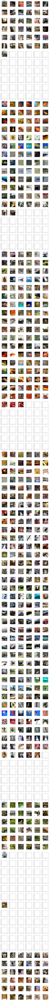

In [8]:
import numpy as np
import matplotlib.pyplot as plt

def display_clusters(cluster_to_images, n_rows=6, n_cols=6):
    """
    Display a grid visualization of clusters.
    
    Parameters:
    - cluster_to_images: A dictionary where keys are cluster IDs and values are lists of images in that cluster.
    - n_rows: Number of rows to display for each cluster.
    - n_cols: Number of columns to display for each cluster.
    """
    
    # Denormalization function
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    
    def denormalize(image):
        image = image.transpose(1, 2, 0)
        image = (image * std) + mean
        return np.clip(image, 0, 1)
    
    n_clusters = len(cluster_to_images)
    
    fig, axes = plt.subplots(n_clusters * n_rows, n_cols, figsize=(n_cols * 2, n_clusters * n_rows * 2))
    
    for cluster_id, images in cluster_to_images.items():
        for i, img in enumerate(images[:n_rows * n_cols]):
            ax = axes[(cluster_id * n_rows) + i // n_cols, i % n_cols]
            ax.imshow(denormalize(img))
            ax.axis('off')
            
            # Set cluster ID as the title for the first image in the cluster
            if i == 0:
                ax.set_title(f"Cluster {cluster_id}")
    
    plt.tight_layout()
    plt.show()

# Assuming `cluster_to_images` is your dictionary mapping cluster IDs to images
display_clusters(cluster_to_images)


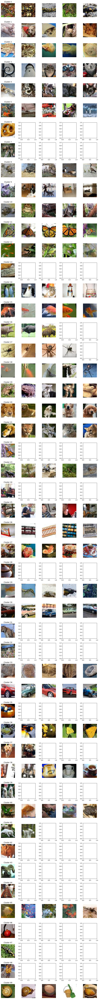

In [23]:
import numpy as np
import matplotlib.pyplot as plt

def display_clusters(cluster_to_images, n_images=5):
    """
    Display a grid visualization of clusters.
    
    Parameters:
    - cluster_to_images: A dictionary where keys are cluster IDs and values are lists of images in that cluster.
    - n_images: Number of representative images to display for each cluster.
    """
    
    # Denormalization function
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    
    def denormalize(image):
        image = image.transpose(1, 2, 0)
        image = (image * std) + mean
        return np.clip(image, 0, 1)
    
    n_clusters = len(cluster_to_images)
    
    fig, axes = plt.subplots(n_clusters, n_images, figsize=(n_images * 2, n_clusters * 2))
    
    for cluster_id, ax_row in zip(cluster_to_images.keys(), axes):
        images = cluster_to_images[cluster_id][:n_images]
        for img, ax in zip(images, ax_row):
            ax.imshow(denormalize(img))
            ax.axis('off')
        
        # Set cluster ID as the title for the first image in each row
        ax_row[0].set_title(f"Cluster {cluster_id}")
    
    plt.tight_layout()
    plt.show()

# Assuming `cluster_to_images` is your dictionary mapping cluster IDs to images
display_clusters(cluster_to_images)


In [ ]:
# Define the mean and standard deviation used for normalization
mean = np.array([0.485, 0.456, 0.406])
std = np.array([0.229, 0.224, 0.225])

cluster_to_images = {i: [] for i in range(n_clusters)}

for i, cluster_id in enumerate(cluster_assignments):
    cluster_to_images[cluster_id].append(image_list[i])

import matplotlib.pyplot as plt

for cluster_id, images in cluster_to_images.items():
    plt.figure(figsize=(10, 10))
    for i, image in enumerate(images[:25]):  # Displaying first 25 images from each cluster
        # Convert from CxHxW to HxWxC
        image = image.transpose(1, 2, 0)
        
        # Denormalize the image
        image = (image * std) + mean
        
        # Clip the values to be in the range [0, 1]
        image = np.clip(image, 0, 1)
        
        plt.subplot(5, 5, i + 1)
        plt.imshow(image)
        plt.axis('off')
    plt.suptitle(f"Cluster {cluster_id}")
    plt.show()

